<a href="https://colab.research.google.com/github/vinay10949/AnalyticsAndML/blob/master/Kaggle/Mercedes-Benz_Greener_Manufacturing/Mercedes_Top2_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

# KAGGLE

<h1 style="text-align:center;font-size:30px;" > Mercedes-Benz Greener Manufacturing </h1>


<h1> 1. Business Problem </h1>

Since the first automobile, the Benz Patent Motor Car in 1886, Mercedes-Benz has stood for important automotive innovations. These include, for example, the passenger safety cell with crumple zone, the airbag and intelligent assistance systems. Mercedes-Benz applies for nearly 2000 patents per year, making the brand the European leader among premium car makers. Daimler’s Mercedes-Benz cars are leaders in the premium car industry. With a huge selection of features and options, customers can choose the customized Mercedes-Benz of their dreams. .

To ensure the safety and reliability of each and every unique car configuration before they hit the road, Daimler’s engineers have developed a robust testing system. But, optimizing the speed of their testing system for so many possible feature combinations is complex and time-consuming without a powerful algorithmic approach. As one of the world’s biggest manufacturers of premium cars, safety and efficiency are paramount on Daimler’s production lines.

In this competition, Daimler is challenging Kagglers to tackle the curse of dimensionality and reduce the time that cars spend on the test bench. Competitors will work with a dataset representing different permutations of Mercedes-Benz car features to predict the time it takes to pass testing. 

Credits : Kaggle

**__Problem Statement__**
- Predict Testing Time for various combination of configurations. 
- This could be useful to priortize the configurations to be tested that could save most of our time. 
- Given a set of feature variables predict testing time.

**Constraints**
1. The cost of a error can be very high.
2. No strict latency concerns.
4. Interpretability is partially important.

**Additional Links**

Shape - https://christophm.github.io/interpretable-ml-book/shap.html

<h3> 2.2.2 Performance Metric </h3>

Source: https://www.kaggle.com/c/mercedes-benz-greener-manufacturing/overview/evaluation

Metric(s): 
*  $R^2$ value, also called the coefficient of determination. 

### <h1> Installing the Libraries </h1>

In [0]:
!pip install yellowbrick
!pip install feature_engine
!pip install featuretools
!pip install catboost
!pip install  category_encoders 
!pip install pycaret
!pip install --user kaggle
!mkdir .kaggle
!pip install prince
!pip install shape

In [0]:
import json
token = {"username":"#####","key":"######"}        
with open('/content/.kaggle/kaggle.json', 'w') as file:
    json.dump(token, file)
!cp /content/.kaggle/kaggle.json ~/.kaggle/kaggle.json
!chmod 600 /root/.kaggle/kaggle.json
!kaggle competitions download -c mercedes-benz-greener-manufacturing

In [0]:
!unzip train.csv.zip
!unzip test.csv.zip
!unzip sample_submission.csv.zip

# Importing essential libraries

In [0]:
import warnings
warnings.filterwarnings("ignore")
import pandas as pd
import pycaret
from sklearn.metrics import r2_score
import seaborn as sns
import matplotlib.pyplot as plt
import numpy as np
import scipy.stats as stats
from sklearn.feature_selection import VarianceThreshold
import pandas
import numpy
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import KFold

from sklearn.model_selection import train_test_split
####Linear Models
from sklearn.linear_model import Lasso
from sklearn.linear_model import ElasticNet
from sklearn.linear_model import MultiTaskLasso
from sklearn.linear_model import MultiTaskElasticNet
from sklearn.linear_model import TheilSenRegressor
######
from sklearn.svm import SVR
from sklearn.pipeline import Pipeline
from sklearn.model_selection import GridSearchCV
from sklearn.linear_model import BayesianRidge
from sklearn.linear_model import LassoLarsIC
from sklearn.linear_model import RidgeCV
from sklearn.linear_model import LarsCV
from sklearn.linear_model import LassoLarsCV
from sklearn.tree import DecisionTreeRegressor
from sklearn.neighbors import KNeighborsRegressor
from sklearn.ensemble import RandomForestRegressor
from sklearn.ensemble import GradientBoostingRegressor
from sklearn.ensemble import ExtraTreesRegressor
from sklearn.ensemble import AdaBoostRegressor
from xgboost import XGBRegressor
from catboost import CatBoostRegressor
from lightgbm import LGBMRegressor
from mlxtend.regressor import StackingRegressor
from sklearn.feature_selection import mutual_info_regression
from sklearn.feature_selection import SelectKBest, SelectPercentile

from feature_engine.categorical_encoders import MeanCategoricalEncoder

In [0]:
train=pd.read_csv("train.csv")
test=pd.read_csv("test.csv")
train_og=train
test_og=test

## Feature Engineering/EDA

## **<h1>Looking out for outliers</h1>**

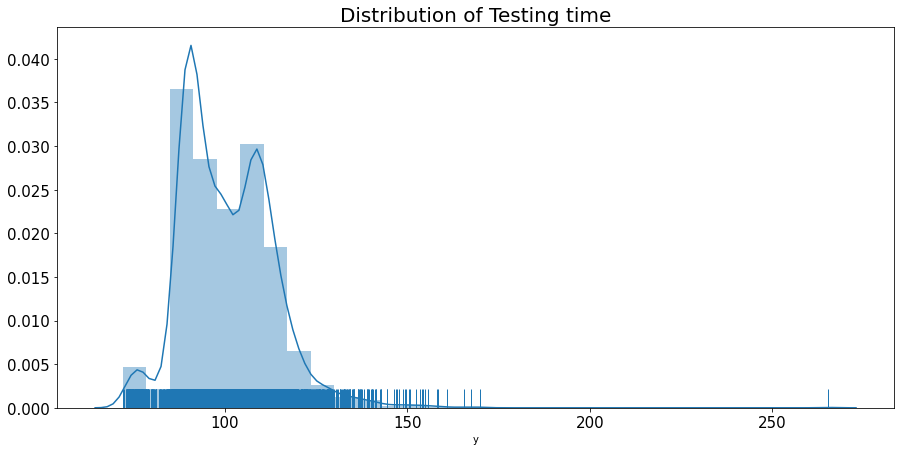

In [0]:
plt.figure(figsize=(15,7))
b=sns.distplot(train['y'],bins=30,rug=True,label="Distribution of Testing time")
b.axes.set_title("Distribution of Testing time",fontsize=20)
#b.set_xlabel("X Label",fontsize=30)
#b.set_ylabel("Y Label",fontsize=20)
b.tick_params(labelsize=15)


In [0]:
train[train['y']<=76]


,ID,y,X0,X1,X2,X3,X4,X5,X6,X8,X10,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20,X21,X22,X23,X24,X26,X27,X28,X29,X30,X31,X32,X33,X34,X35,X36,X37,X38,X39,X40,...,X345,X346,X347,X348,X349,X350,X351,X352,X353,X354,X355,X356,X357,X358,X359,X360,X361,X362,X363,X364,X365,X366,X367,X368,X369,X370,X371,X372,X373,X374,X375,X376,X377,X378,X379,X380,X382,X383,X384,X385
91,197,73.70,az,y,as,c,d,j,j,q,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,1,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
321,639,74.00,az,l,n,f,d,i,g,s,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
360,713,74.28,az,m,r,f,d,d,i,s,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,1,0,0,1,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
368,732,73.34,az,v,n,f,d,d,j,f,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
573,1121,75.86,az,l,n,f,d,c,g,w,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
3973,7969,74.62,az,l,n,f,d,w,a,n,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
3983,7987,74.08,az,v,n,f,d,w,g,f,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
4019,8060,74.75,az,w,n,f,d,w,k,j,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
4060,8133,75.90,az,l,n,f,d,w,g,s,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0


In [0]:
def diagnostic_plots(df, variable):
    # function takes a dataframe (df) and
    # the variable of interest as arguments

    # define figure size
    plt.figure(figsize=(16, 4))

    # histogram
    plt.subplot(1, 3, 1)
    sns.distplot(df[variable], bins=30)
    plt.title('Histogram')

    # Q-Q plot
    plt.subplot(1, 3, 2)
    stats.probplot(df[variable], dist="norm", plot=plt)
    plt.ylabel('Variable quantiles')

    # boxplot
    plt.subplot(1, 3, 3)
    sns.boxplot(y=df[variable])
    plt.title('Boxplot')

    plt.show()

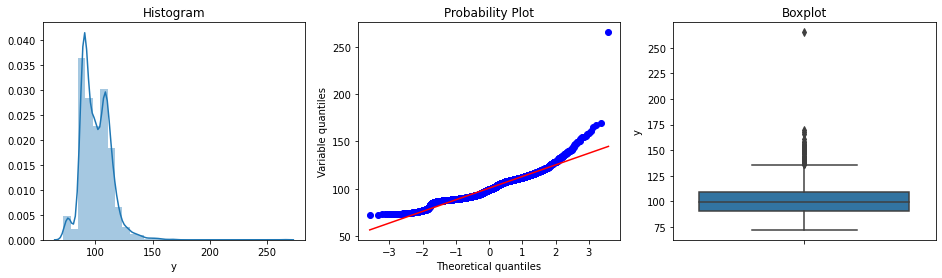

In [10]:
diagnostic_plots(train,'y')


In [11]:
train['y'].quantile([.02,.9,.95,.995])
train[(train['y']>76) & (train['y']<139)]


,ID,y,X0,X1,X2,X3,X4,X5,X6,X8,X10,X11,X12,X13,X14,X15,X16,X17,X18,X19,X20,X21,X22,X23,X24,X26,X27,X28,X29,X30,X31,X32,X33,X34,X35,X36,X37,X38,X39,X40,...,X345,X346,X347,X348,X349,X350,X351,X352,X353,X354,X355,X356,X357,X358,X359,X360,X361,X362,X363,X364,X365,X366,X367,X368,X369,X370,X371,X372,X373,X374,X375,X376,X377,X378,X379,X380,X382,X383,X384,X385
0,0,130.81,k,v,at,a,d,u,j,o,0,0,0,1,0,0,0,0,1,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
1,6,88.53,k,t,av,e,d,y,l,o,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,1,0,0,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
2,7,76.26,az,w,n,c,d,x,j,x,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0
3,9,80.62,az,t,n,f,d,x,l,e,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0
4,13,78.02,az,v,n,f,d,h,d,n,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,1,1,0,1,0,0,0,1,0,1,0,0,0,...,0,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
4204,8405,107.39,ak,s,as,c,d,aa,d,q,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,1,0,0,...,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,0,1,0,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0
4205,8406,108.77,j,o,t,d,d,aa,h,h,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1,0,0,0,0,0,1,0,0,0,0,0,0,0,0
4206,8412,109.22,ak,v,r,a,d,aa,g,e,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,1,0,0,0,1,0,1,1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
4207,8415,87.48,al,r,e,f,d,aa,l,u,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,...,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,1,1,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0


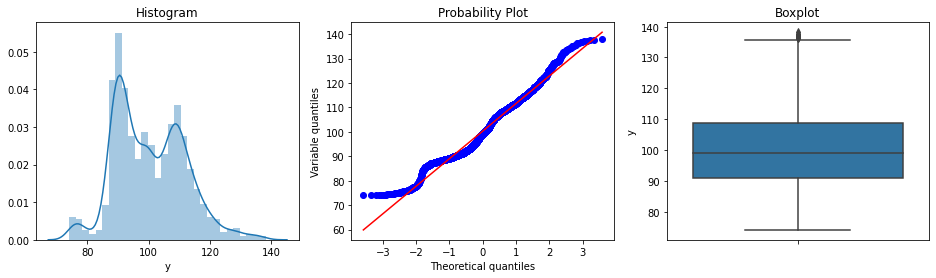

In [12]:
diagnostic_plots(train[(train['y']>74) & (train['y']<139)],'y')

In [0]:
train=train[(train['y']>74) & (train['y']<139)]

# Dropping columns that show low variance

In [78]:
sel = VarianceThreshold(threshold=0)
a=train.select_dtypes(include='int64')
sel.fit(a)  

VarianceThreshold(threshold=0)

In [0]:

columnsWithZeroVariance=[x for x in a.columns if x not in a.columns[sel.get_support()]]
train=train.drop(columnsWithZeroVariance,axis=1)
test=test.drop(columnsWithZeroVariance,axis=1)

In [80]:
selQuasi = VarianceThreshold(
    threshold=0.01)  # 0.01 indicates 99% of observations approximately
a=train.select_dtypes(include='int64')
selQuasi.fit(a)
# finally we can print the constant features
print(
    len([
        x for x in a.columns
        if x not in a.columns[selQuasi.get_support()]
    ]))

quasiColumnsToBeDropped=[x for x in a.columns if x not in a.columns[selQuasi.get_support()]]

135


In [0]:
train=train.drop(quasiColumnsToBeDropped,axis=1)
test=test.drop(quasiColumnsToBeDropped,axis=1)

In [0]:
train.to_csv("train_new.csv",index=False)

In [83]:
train.select_dtypes(include='object')


,X0,X1,X2,X3,X4,X5,X6,X8
0,k,v,at,a,d,u,j,o
1,k,t,av,e,d,y,l,o
2,az,w,n,c,d,x,j,x
3,az,t,n,f,d,x,l,e
4,az,v,n,f,d,h,d,n
...,...,...,...,...,...,...,...,...
4204,ak,s,as,c,d,aa,d,q
4205,j,o,t,d,d,aa,h,h
4206,ak,v,r,a,d,aa,g,e
4207,al,r,e,f,d,aa,l,u


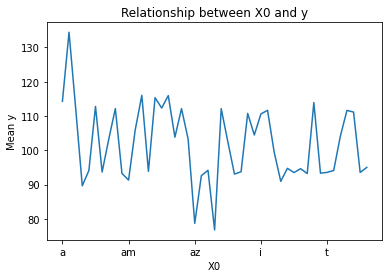

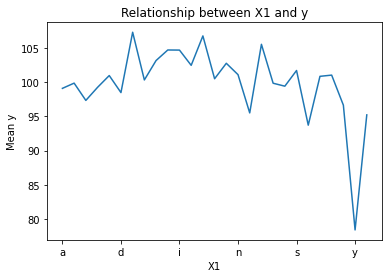

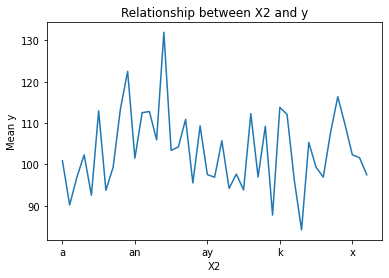

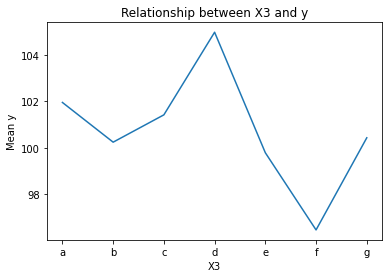

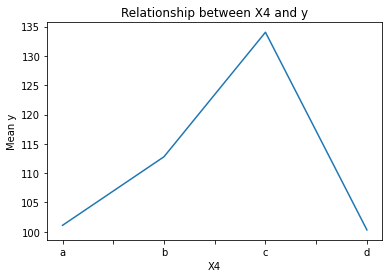

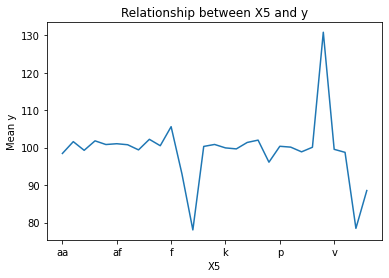

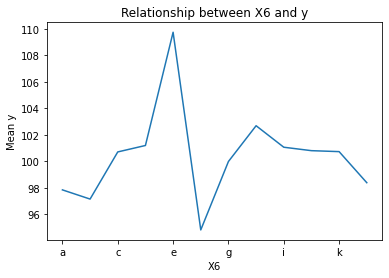

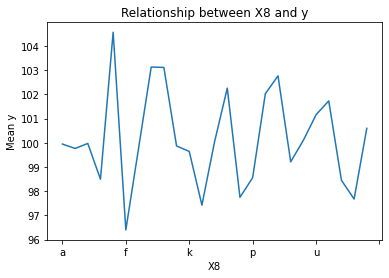

In [84]:
cat_cols=list(train.select_dtypes(include='object').columns)
for var in cat_cols:
    fig = plt.figure()
    fig = train.groupby([var])['y'].mean().plot()
    fig.set_title('Relationship between {} and y'.format(var))
    fig.set_ylabel('Mean y')
    plt.show()

# OrdinalEncoding +SpotChecking Regression Models (WorstPerformance on test set)



In [0]:

ordinal_enc = OrdinalCategoricalEncoder(
    # NOTE that we indicate ordered in the encoding_method, otherwise it assings numbers arbitrarily
    encoding_method='ordered',
    variables=cat_cols)
ordinal_enc.fit(train.drop('y',axis=1),train['y'])

['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']

In [0]:
#for Linear Models
train_ordinal_enc = ordinal_enc.transform(train.drop('y',axis=1))
test_ordinal_enc = ordinal_enc.transform(test)
train_ordinal_enc['y']=train['y']
# let's explore the result
train_ordinal_enc.head()



int64      221
object       8
float64      1
dtype: int64

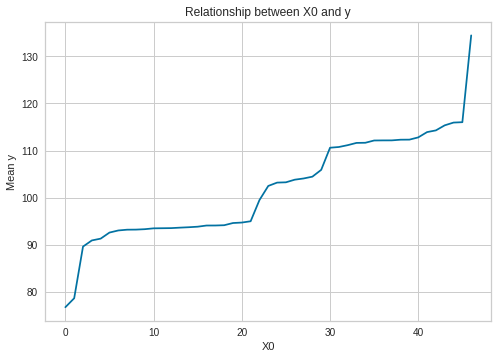

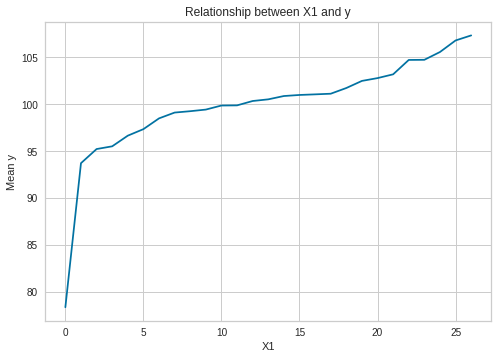

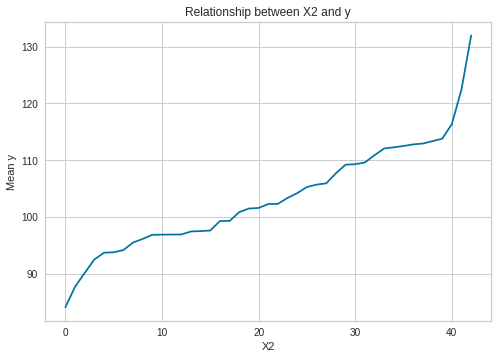

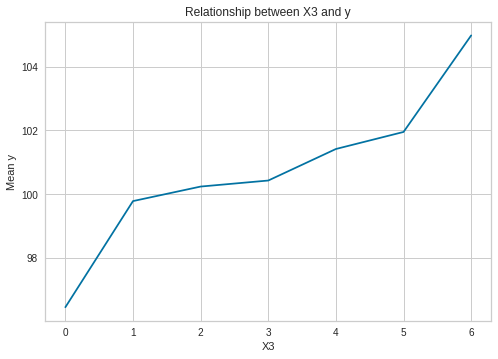

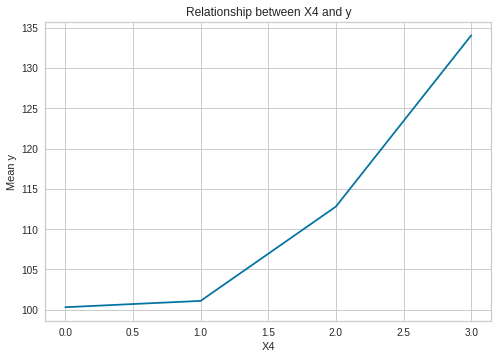

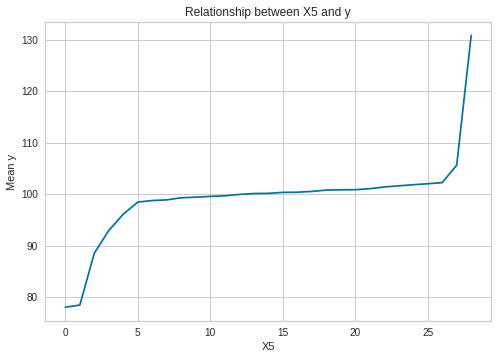

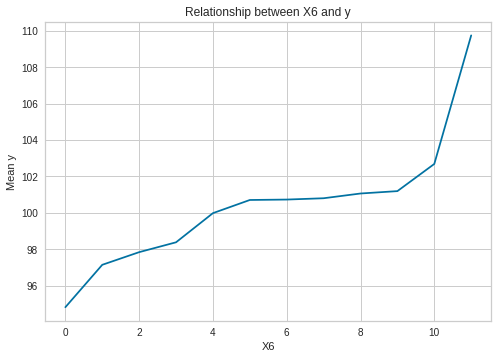

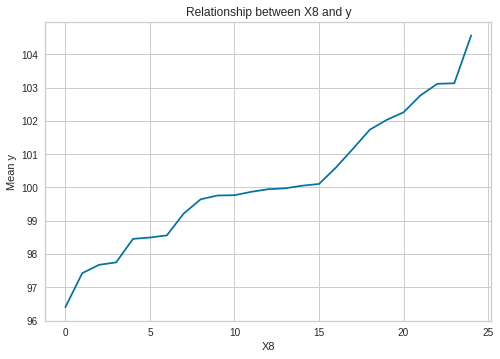

In [0]:
cat_cols=list(train.select_dtypes(include='object').columns)
for var in cat_cols:
    fig = plt.figure()
    fig = train_ordinal_enc.groupby([var])['y'].mean().plot()
    fig.set_title('Relationship between {} and y'.format(var))
    fig.set_ylabel('Mean y')
    plt.show()

LASSO: 0.594301 (0.053788)
EN: 0.601174 (0.053348)
BayesianRidge: 0.616471 (0.052488)
LassoLarsIC: 0.623521 (0.052875)
RidgeCV: 0.607816 (0.047987)
LarsCV: 0.619981 (0.052093)
LassoLarsCV: 0.623386 (0.052727)
[11:05:07] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:05:08] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:05:09] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:05:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:05:12] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:05:13] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[11:05:14] WARNING: /workspac

[Text(0, 0, 'LASSO'),
 Text(0, 0, 'EN'),
 Text(0, 0, 'BayesianRidge'),
 Text(0, 0, 'LassoLarsIC'),
 Text(0, 0, 'RidgeCV'),
 Text(0, 0, 'LarsCV'),
 Text(0, 0, 'LassoLarsCV'),
 Text(0, 0, 'XGBRegressor'),
 Text(0, 0, 'LGBMRegressor'),
 Text(0, 0, 'Catboost')]

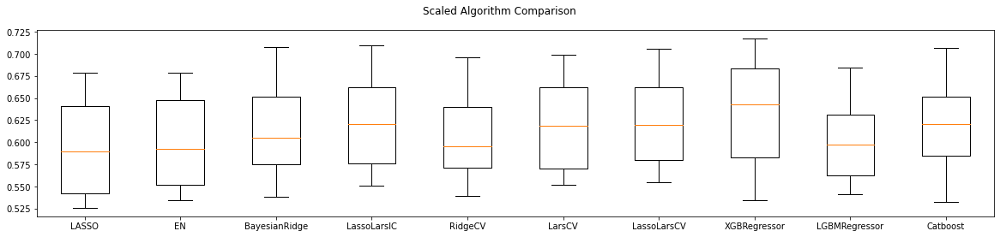

In [0]:
# Standardize the dataset
from sklearn.model_selection import cross_val_score

##Linear +Non Linear models with Ordinal Encoding
pipelines = []
pipelines.append(('LASSO', Pipeline([('Scaler', StandardScaler()),('LASSO', Lasso())])))
pipelines.append(('EN', Pipeline([('Scaler', StandardScaler()),('EN', ElasticNet())])))
pipelines.append(('BayesianRidge', Pipeline([('Scaler', StandardScaler()),('BayesianRidge', BayesianRidge())])))
pipelines.append(('LassoLarsIC', Pipeline([('Scaler', StandardScaler()),('LassoLarsIC', LassoLarsIC())])))
pipelines.append(('RidgeCV', Pipeline([('Scaler', StandardScaler()),('RidgeCV', RidgeCV())])))
pipelines.append(('LarsCV', Pipeline([('Scaler', StandardScaler()),('LarsCV', LarsCV())])))
pipelines.append(('LassoLarsCV', Pipeline([('Scaler', StandardScaler()),('LassoLarsCV', LassoLarsCV())])))
#pipelines.append(('KNeighborsRegressor', Pipeline([('Scaler', StandardScaler()),('KNeighborsRegressor', KNeighborsRegressor())])))
#pipelines.append(('RandomForestRegressor', Pipeline([('Scaler', StandardScaler()),('RandomForestRegressor', RandomForestRegressor())])))
#pipelines.append(('ScaledAB', Pipeline([('Scaler', StandardScaler()),('AB', AdaBoostRegressor())])))
#pipelines.append(('ScaledGBM', Pipeline([('Scaler', StandardScaler()),('GBM', GradientBoostingRegressor())])))
#pipelines.append(('ScaledRF', Pipeline([('Scaler', StandardScaler()),('RF', RandomForestRegressor())])))
pipelines.append(('XGBRegressor', Pipeline([('Scaler', StandardScaler()),('XGB', XGBRegressor(verbose=0))])))
pipelines.append(('LGBMRegressor', Pipeline([('Scaler', StandardScaler()),('LightGBM', LGBMRegressor(verbose=0))])))
pipelines.append(('Catboost', Pipeline([('Scaler', StandardScaler()),('Catboost', CatBoostRegressor(verbose=0))])))

results = []
names = []
for name, model in pipelines:
	kfold = KFold(n_splits=10, random_state=10)
	cv_results = cross_val_score(model, X_train_ordinal_enc, y_train_ordinal_enc, cv=kfold, scoring='r2')
	results.append(cv_results)
	names.append(name)
	msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
	print(msg)

# Compare Algorithms
fig = pyplot.figure()
dir(fig)
fig.set_figwidth(20)
fig.suptitle('Scaled Algorithm Comparison')
ax = fig.add_subplot(111)
pyplot.boxplot(results)
ax.set_xticklabels(names)


[11:41:52] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.5239028268755399


# Categorical Encoding + SpotCheckingRegressionModels+Good Performance on test set

In [86]:


import category_encoders as ce
encoder = ce.JamesSteinEncoder(cols=cat_cols)
encoder.fit(train.drop('y',axis=1),train['y'])

X_train_JamesSteinEncoded=encoder.transform(train.drop('y',axis=1))
X_test_JamesSteinEncoded=encoder.transform(test)
X_train_JamesSteinEncoded.head()


# let's separate into training and testing set

X_train_js_enc, X_test_js_enc, y_train_js_enc, y_test_js_enc = train_test_split(
    X_train_JamesSteinEncoded,  # predictors
    train['y'],  # target
    test_size=0.3,  # percentage of obs in test set
    random_state=0)  # seed to ensure reproducibility

X_train_js_enc.shape, X_test_js_enc.shape



((2902, 229), (1245, 229))

LASSO: 0.625393 (0.057940)
EN: 0.610566 (0.054945)
BayesianRidge: 0.625187 (0.056604)
LassoLarsIC: 0.642570 (0.057734)
RidgeCV: 0.619827 (0.054316)
LarsCV: 0.644631 (0.057086)
LassoLarsCV: 0.644257 (0.057210)
KNN: 0.447685 (0.064724)
AB: 0.565333 (0.063139)
GBM: 0.634681 (0.055351)
RF: 0.587049 (0.047410)
[13:14:24] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[13:14:26] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[13:14:27] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[13:14:28] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[13:14:29] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
[13:14:30] WARNING: /workspace/src/objective/regression_ob

[Text(0, 0, 'LASSO'),
 Text(0, 0, 'EN'),
 Text(0, 0, 'BayesianRidge'),
 Text(0, 0, 'LassoLarsIC'),
 Text(0, 0, 'RidgeCV'),
 Text(0, 0, 'LarsCV'),
 Text(0, 0, 'LassoLarsCV'),
 Text(0, 0, 'KNN'),
 Text(0, 0, 'AB'),
 Text(0, 0, 'GBM'),
 Text(0, 0, 'RF'),
 Text(0, 0, 'XGB'),
 Text(0, 0, 'LGBM'),
 Text(0, 0, 'Catboost')]

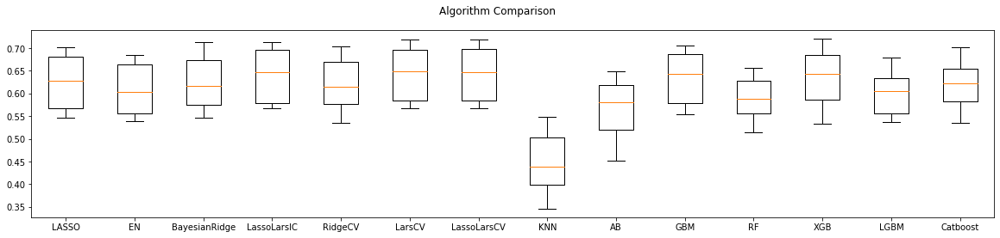

In [0]:
# Standardize the dataset
from sklearn.model_selection import cross_val_score
from mlxtend.regressor import StackingRegressor


##Linear +Non Linear models with Ordinal Encoding
pipelines = []
pipelines.append(('LASSO', Pipeline([('Scaler', StandardScaler()),('LASSO', Lasso())])))
pipelines.append(('EN', Pipeline([('Scaler', StandardScaler()),('EN', ElasticNet())])))
pipelines.append(('BayesianRidge', Pipeline([('Scaler', StandardScaler()),('BayesianRidge', BayesianRidge())])))
pipelines.append(('LassoLarsIC', Pipeline([('Scaler', StandardScaler()),('LassoLarsIC', LassoLarsIC())])))
pipelines.append(('RidgeCV', Pipeline([('Scaler', StandardScaler()),('RidgeCV', RidgeCV())])))
pipelines.append(('LarsCV', Pipeline([('Scaler', StandardScaler()),('LarsCV', LarsCV())])))
pipelines.append(('LassoLarsCV', Pipeline([('Scaler', StandardScaler()),('LassoLarsCV', LassoLarsCV())])))
pipelines.append(('KNN', Pipeline([('Scaler', StandardScaler()),('KNeighborsRegressor', KNeighborsRegressor())])))
pipelines.append(('AB', Pipeline([('Scaler', StandardScaler()),('AB', AdaBoostRegressor())])))
pipelines.append(('GBM', Pipeline([('Scaler', StandardScaler()),('GBM', GradientBoostingRegressor())])))
pipelines.append(('RF', Pipeline([('Scaler', StandardScaler()),('RF', RandomForestRegressor())])))
pipelines.append(('XGB', Pipeline([('Scaler', StandardScaler()),('XGB', XGBRegressor(verbose=0))])))
pipelines.append(('LGBM', Pipeline([('Scaler', StandardScaler()),('LightGBM', LGBMRegressor(verbose=0))])))
pipelines.append(('Catboost', Pipeline([('Scaler', StandardScaler()),('Catboost', CatBoostRegressor(verbose=0))])))

results = []
names = []
for name, model in pipelines:
	kfold = KFold(n_splits=10, random_state=10)
	cv_results = cross_val_score(model, X_train_js_enc, y_train_js_enc, cv=kfold, scoring='r2')
	results.append(cv_results)
	names.append(name)
	msg = "%s: %f (%f)" % (name, cv_results.mean(), cv_results.std())
	print(msg)

# Compare Algorithms
fig = plt.figure()
dir(fig)
fig.set_figwidth(20)
fig.suptitle('Algorithm Comparison')
ax = fig.add_subplot(111)
plt.boxplot(results)
ax.set_xticklabels(names)


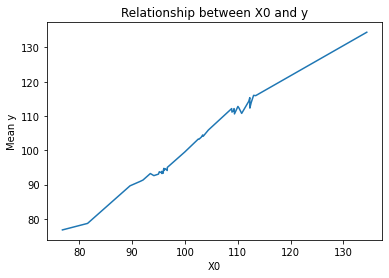

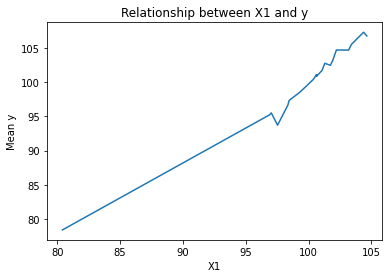

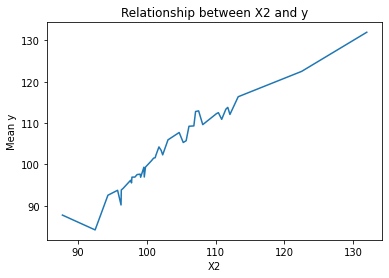

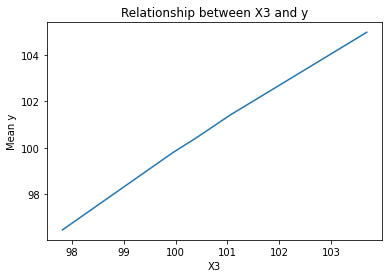

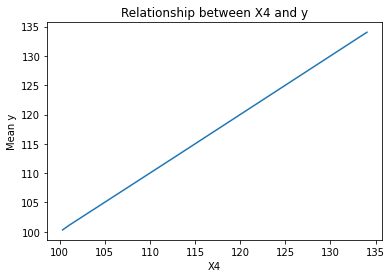

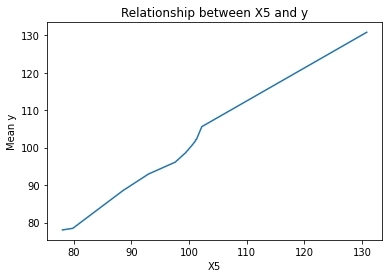

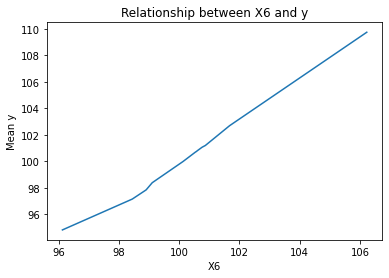

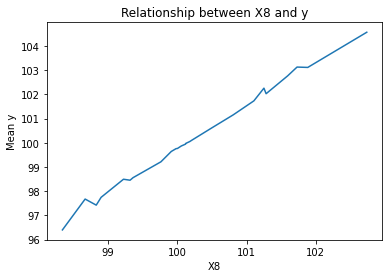

In [87]:

#### JamesSeinEncoding Created Cool Linear Relationship
t=X_train_JamesSteinEncoded
t['y']=train['y']
cat_cols=list(train.select_dtypes(include='object').columns)

for var in cat_cols:
    fig = plt.figure()
    fig = t.groupby([var])['y'].mean().plot()
    fig.set_title('Relationship between {} and y'.format(var))
    fig.set_ylabel('Mean y')
    plt.show()

### Stacking R^2Score 0.6515

In [88]:
list(X_train_js_enc.drop(['ID','X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8'],axis=1).columns)
lasso=Lasso()
larsCV=LarsCV(normalize=False)
xgb=XGBRegressor(max_depth=1,silent=True)
lrs=LassoLarsIC()
lv=LassoLarsCV()

b=LassoLarsCV(normalize=True)
b.fit(X_train_js_enc,y_train_js_enc)
y_pred=b.predict(X_test_js_enc)
print("LV Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=LarsCV(normalize=True)
b.fit(X_train_js_enc,y_train_js_enc)
y_pred=b.predict(X_test_js_enc)
print("LarsCV Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=LassoLarsIC(criterion='aic',normalize=False)
b.fit(X_train_js_enc,y_train_js_enc)
y_pred=b.predict(X_test_js_enc)
print("LassoLarsIC Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=XGBRegressor(max_depth=1,n_estimators=100,silent=True)
b.fit(X_train_js_enc,y_train_js_enc)
y_pred=b.predict(X_test_js_enc)
print("XGB Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=CatBoostRegressor(max_depth=3,n_estimators=650,learning_rate=0.03,bagging_temperature=10,silent=True)
b.fit(X_train_js_enc,y_train_js_enc)
y_pred=b.predict(X_test_js_enc)
print("CatBoost Test R^2Score",r2_score(y_test_js_enc,y_pred))

xgb=XGBRegressor(max_depth=1,n_estimators=100,silent=True)

ct=CatBoostRegressor(max_depth=3,n_estimators=650,learning_rate=0.03,bagging_temperature=10,silent=True)

elasticNet=ElasticNet()
stack = StackingRegressor(regressors=(larsCV, lrs,lv,xgb),meta_regressor=elasticNet)
stack.fit(X_train_js_enc,y_train_js_enc)
y_pred=stack.predict(X_test_js_enc)
print("stack Test R^2Score",r2_score(y_test_js_enc,y_pred))


elasticNet=ElasticNet()
stack = StackingRegressor(regressors=(larsCV, lrs,lv,xgb),meta_regressor=elasticNet)
stack.fit(X_train_js_enc,y_train_js_enc)
y_pred=stack.predict(X_test_js_enc)
print("stack Test R^2Score",r2_score(y_test_js_enc,y_pred))


y_test_pred=stack.predict(X_test_JamesSteinEncoded)
X_test_JamesSteinEncoded['y']=y_test_pred
X_test_JamesSteinEncoded[['ID','y']].to_csv("submission1.csv",index=False)

X_test_JamesSteinEncoded.drop('y',axis=1,inplace=True)

LV Test R^2Score 0.6492006880853842
LarsCV Test R^2Score 0.6494885872095508
LassoLarsIC Test R^2Score 0.6476264116090005
XGB Test R^2Score 0.6400064437073788
CatBoost Test R^2Score 0.645138733705293
stack Test R^2Score 0.6515276161181993
stack Test R^2Score 0.6515276161181993


### Sparse PCA +  R^2 Stacking 0.6473

In [0]:
!pip install prince

In [0]:
import prince
ca = prince.CA(n_components=150,
     n_iter=10,
     copy=True,
     check_input=True,
     engine='auto',
     random_state=40,
     benzecri=False
 )

In [0]:
A_train=X_train_js_enc[list(X_train_js_enc.drop(['ID','X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8'],axis=1).columns)]
A_test=X_test_js_enc[list(X_test_js_enc.drop(['ID','X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8'],axis=1).columns)]

#ca = ca.fit(A_train)

#A.replace(to_replace = 2, value = 0, inplace = True)
#b=mca.transform(A)
#B_train=ca.transform(A_train)
#B_test=ca.transform(A_test)

#B_train[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']] = X_train_js_enc[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']]
#B_test[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']] = X_test_js_enc[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']]
#B_train[list(X_train_js_enc.columns)] = X_train_js_enc[list(X_train_js_enc.columns)]
#B_test[list(X_test_js_enc.columns)] = X_test_js_enc[list(X_test_js_enc.columns)]
B_train.shape,B_test.shape



((2902, 278), (1245, 278))

In [0]:
import numpy as np
from sklearn.datasets import make_friedman1
from sklearn.decomposition import SparsePCA
n_comp=120
transformer = SparsePCA(n_components=n_comp, random_state=0)
transformer.fit(A_train)

sparcepca_results_train = transformer.transform(A_train)
sparcepca_results_test = transformer.transform(A_test)



np.mean(transformer.components_ == 0)  #98%
for i in range(1, n_comp + 1):
    A_train['sparcepca_' + str(i)] = sparcepca_results_train[:, i - 1]
    A_test['sparcepca_' + str(i)] = sparcepca_results_test[:, i - 1]

In [0]:
A_train[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']] = X_train_js_enc[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']]
A_test[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']] = X_test_js_enc[['X0', 'X1', 'X2', 'X3', 'X4', 'X5', 'X6', 'X8']]


In [0]:
lasso=Lasso()
larsCV=LarsCV(normalize=False)
xgb=XGBRegressor(max_depth=1,silent=True)
lrs=LassoLarsIC()
lv=LassoLarsCV()

b=LassoLarsCV(normalize=True)
b.fit(A_train,y_train_js_enc)
y_pred=b.predict(A_test)
print("LV Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=LarsCV(normalize=True)
b.fit(A_train,y_train_js_enc)
y_pred=b.predict(A_test)
print("LarsCV Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=LassoLarsIC(criterion='aic',normalize=False)
b.fit(A_train,y_train_js_enc)
y_pred=b.predict(A_test)
print("LassoLarsIC Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=XGBRegressor(max_depth=2,n_estimators=100,silent=True)
b.fit(A_train,y_train_js_enc)
y_pred=b.predict(A_test)
print("XGB Test R^2Score",r2_score(y_test_js_enc,y_pred))

b=CatBoostRegressor(max_depth=3,n_estimators=600,learning_rate=0.03,bagging_temperature=10,silent=True)
b.fit(A_train,y_train_js_enc)
y_pred=b.predict(A_test)
print("CatBoost Test R^2Score",r2_score(y_test_js_enc,y_pred))

xgb=XGBRegressor(max_depth=1,n_estimators=100,silent=True)
ct=CatBoostRegressor(max_depth=3,n_estimators=650,learning_rate=0.03,bagging_temperature=10,silent=True)

elasticNet=ElasticNet()
stack = StackingRegressor(regressors=(larsCV, lrs,lv,elasticNet),meta_regressor=xgb)
stack.fit(A_train,y_train_js_enc)
y_pred=stack.predict(A_test)
print("stack Test R^2Score",r2_score(y_test_js_enc,y_pred))



LV Test R^2Score 0.6491428709198217


In [0]:
x=XGBRegressor()
subsample = [0.1, 0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 1.0]
param_grid = dict(subsample=subsample)
kfold = KFold(n_splits=10, random_state=10)
grid_search = GridSearchCV(x, param_grid, scoring="r2", n_jobs=-1, cv=kfold)
result = grid_search.fit(X_train_js_enc, y_train_js_enc)
# summarize results
print("Best: %f using %s" % (result.best_score_, result.best_params_))


[16:07:11] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
Best: 0.634958 using {'subsample': 1.0}


# Bivariate Analysis

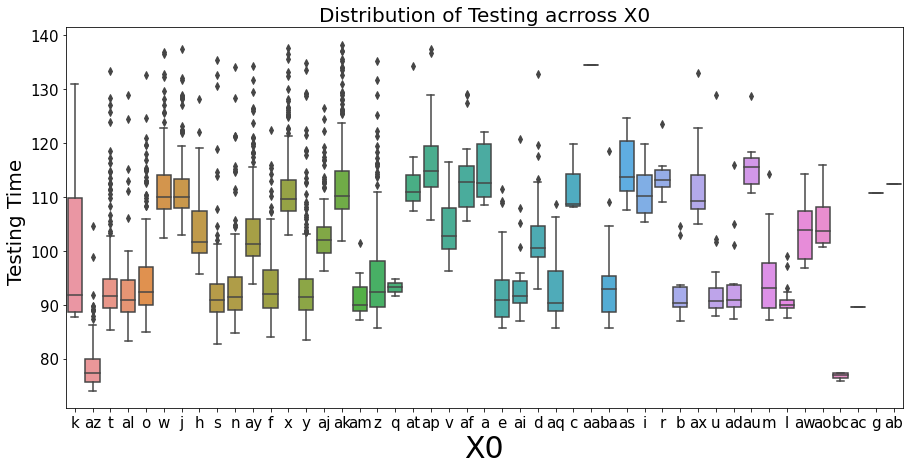

In [0]:
plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X0", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X0",fontsize=20)
ax.set_xlabel("X0",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)



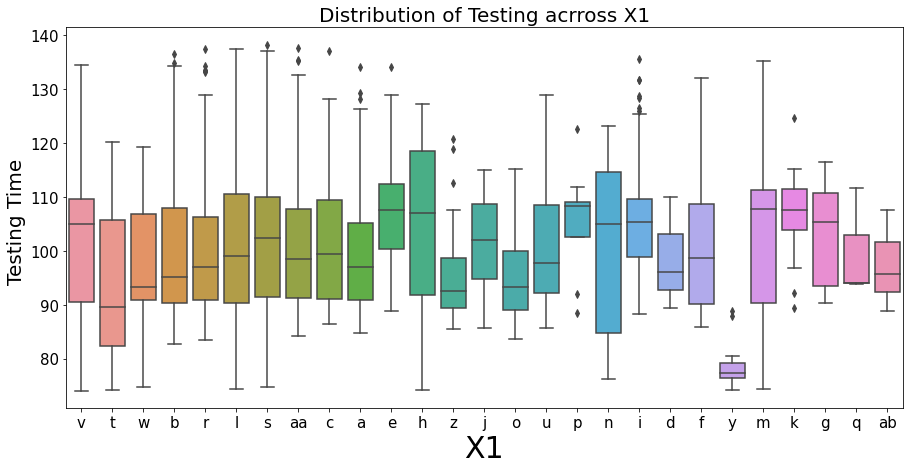

In [0]:
plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X1", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X1",fontsize=20)
ax.set_xlabel("X1",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)



**<h2>X1==y has lowest testing time ,Most of them have testing time between 90 and 110</h2>**

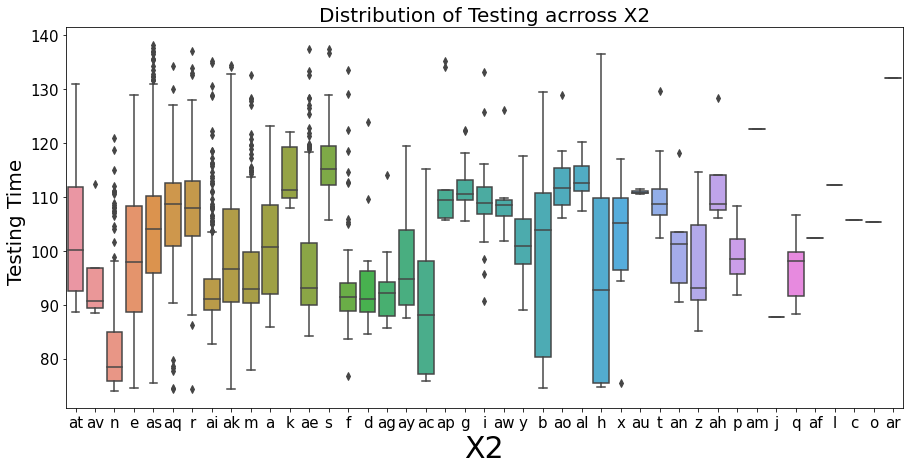

In [0]:
plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X2", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X2",fontsize=20)
ax.set_xlabel("X2",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)



**<h1>No Significant Observation for X3</h1>**

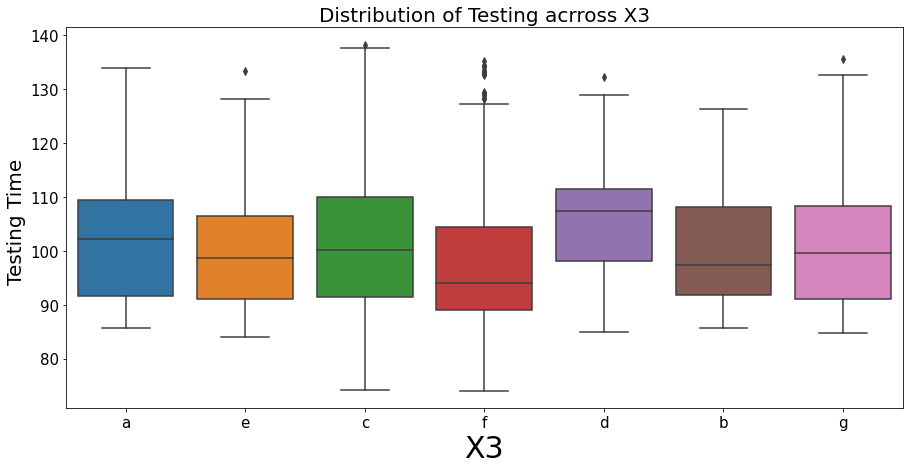

In [0]:
plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X3", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X3",fontsize=20)
ax.set_xlabel("X3",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)



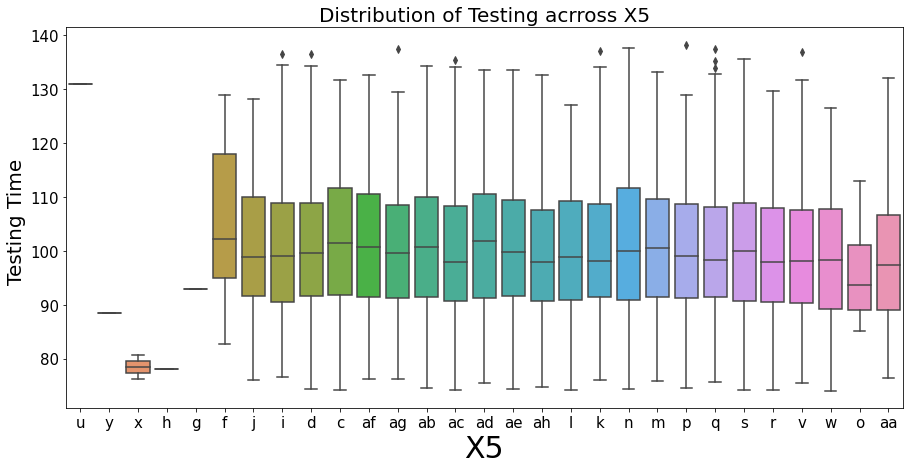

In [0]:


plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X5", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X5",fontsize=20)
ax.set_xlabel("X5",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)


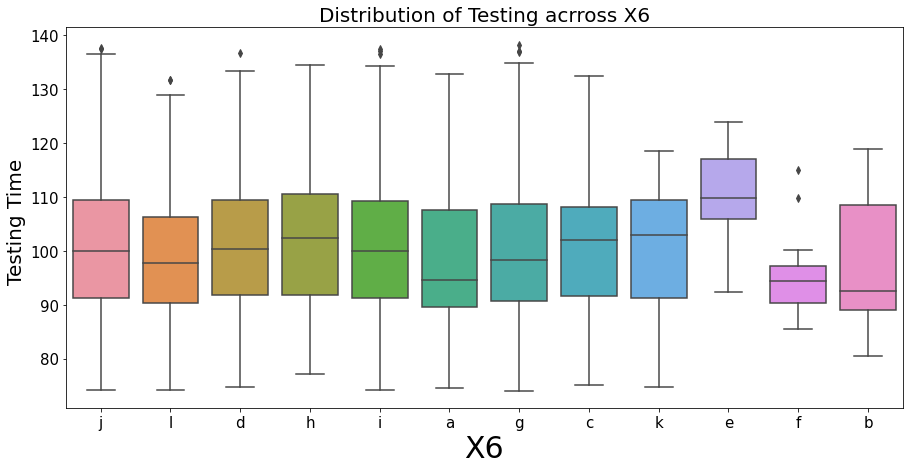

In [0]:

plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X6", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X6",fontsize=20)
ax.set_xlabel("X6",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)


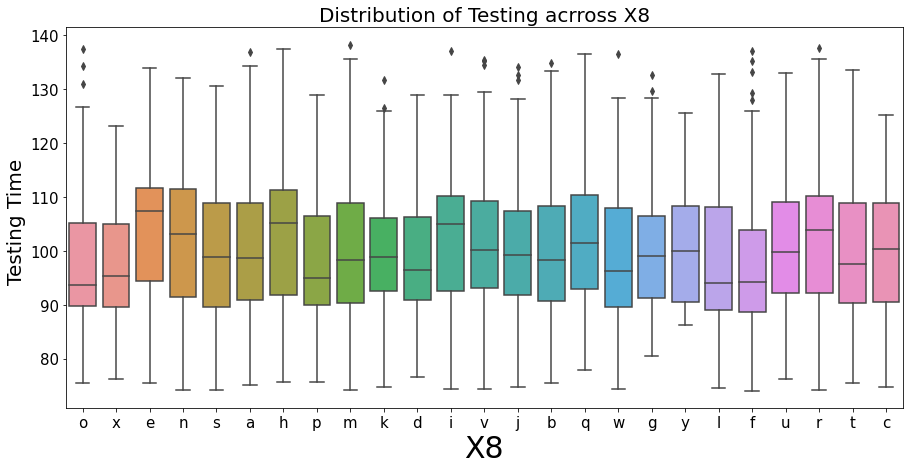

In [0]:

plt.figure(figsize=(15,7))
ax = sns.boxplot(x="X8", y="y", data=train)
ax.axes.set_title("Distribution of Testing acrross X8",fontsize=20)
ax.set_xlabel("X8",fontsize=30)
ax.set_ylabel("Testing Time ",fontsize=20)
ax.tick_params(labelsize=15)


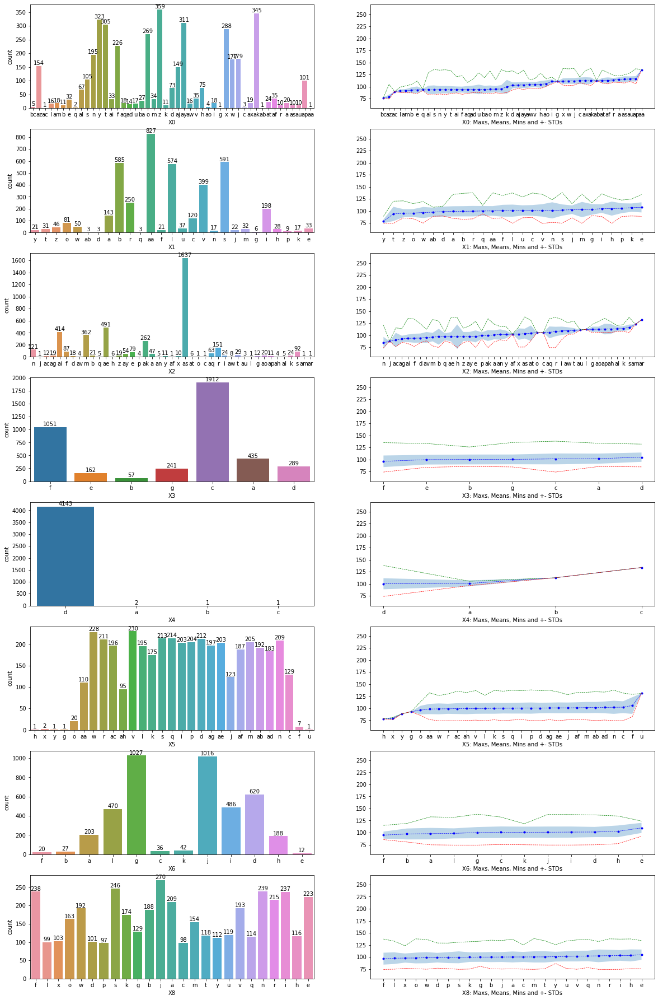

In [0]:
plt.figure(figsize=(20,32))
cat_cols=train.select_dtypes(include='object').columns

for i in range(len(cat_cols)):
    c = cat_cols[i]
    
    means = train.groupby(c).y.mean()
    stds = train.groupby(c).y.std().fillna(0)
    maxs = train.groupby(c).y.max()
    mins = train.groupby(c).y.min()
    
    ddd = pd.concat([means, stds, maxs, mins], axis=1); 
    ddd.columns = ['means', 'stds', 'maxs', 'mins']
    ddd.sort_values('means', inplace=True)
    
    plt.subplot(8,2,2*i+1)
    ax = sns.countplot(train[c], order=ddd.index.values)
    for p in ax.patches:
        x=p.get_bbox().get_points()[:,0]
        y=p.get_bbox().get_points()[1,1]
        ax.annotate('{:.0f}'.format(y), (x.mean(), y), ha='center', va='bottom')
    
    plt.subplot(8,2,2*i+2)
    plt.fill_between(range(len(train[c].unique())), 
                     ddd.means.values - ddd.stds.values,
                     ddd.means.values + ddd.stds.values,
                     alpha=0.3
                    )
    plt.xticks(range(len(train[c].unique())), ddd.index.values)
    plt.plot(ddd.means.values, color='b', marker='.', linestyle='dashed', linewidth=0.7)
    plt.plot(ddd.maxs.values, color='g', linestyle='dashed', linewidth=0.7)
    plt.plot(ddd.mins.values, color='r', linestyle='dashed', linewidth=0.7)
    plt.xlabel(c + ': Maxs, Means, Mins and +- STDs')
    plt.ylim(55, 270)


# Model Interpretibilty

In [92]:

c=LassoLarsCV(normalize=True)
c.fit(X_train_js_enc,y_train_js_enc)
y_pred=c.predict(X_test_js_enc)
print("LV Test R^2Score",r2_score(y_test_js_enc,y_pred))

LV Test R^2Score 0.6492006880853842


In [89]:
!pip install shap

In [95]:
import shap
shap.initjs()

explainer = shap.LinearExplainer(data=X_train_js_enc,model=c)
shap_values = explainer.shap_values(X_train_js_enc)


shap.force_plot(explainer.expected_value, shap_values, X_train_js_enc)


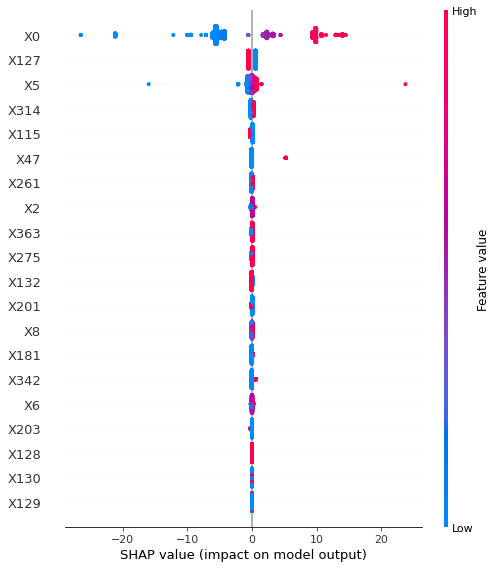

In [96]:

shap.initjs()
shap.summary_plot(shap_values,  X_train_js_enc)


**<h2>Model shows X0 has high impact on to lower and higher values of testing time,More the X0 more the testing time,Less the X0 less the Testing time</h2>**

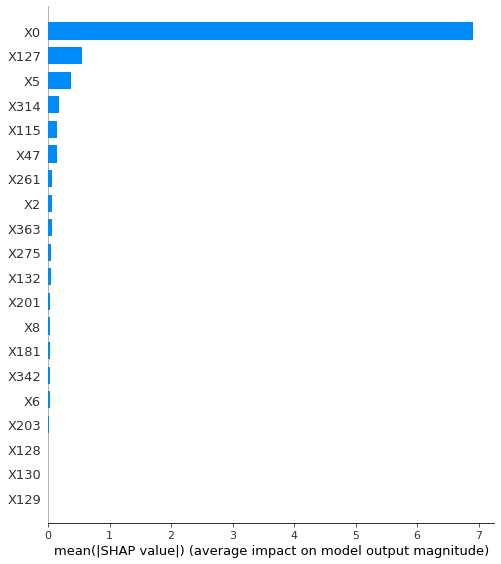

In [100]:

shap.summary_plot(shap_values,  X_train_js_enc, auto_size_plot=False,plot_type='bar')


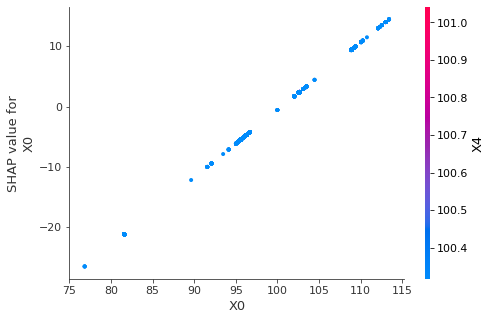

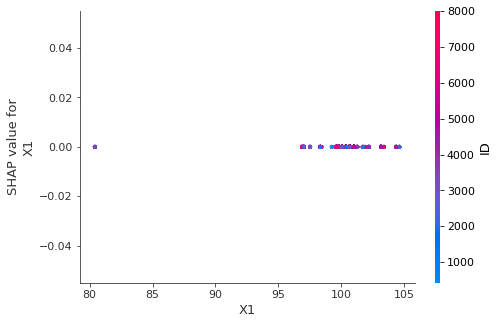

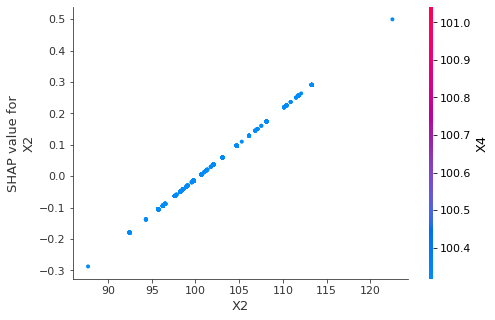

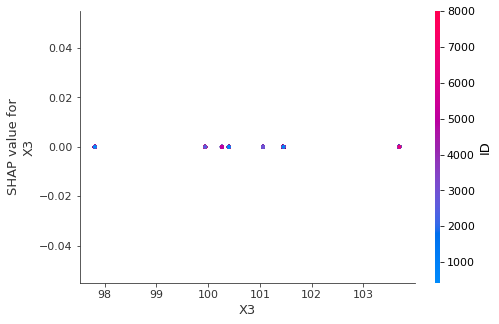

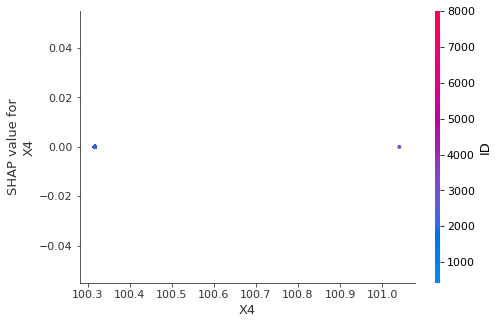

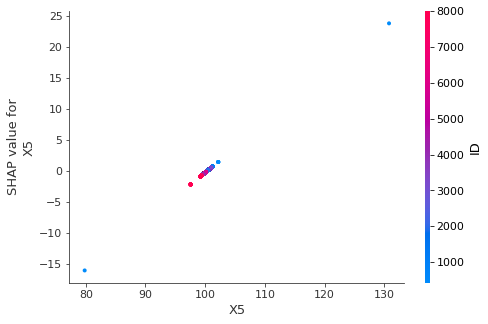

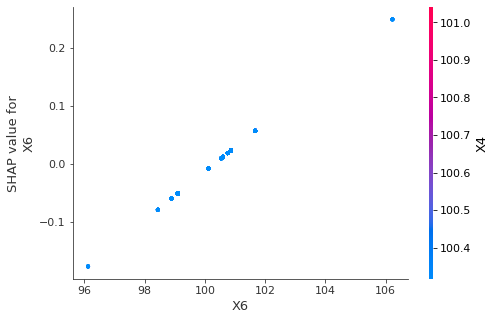

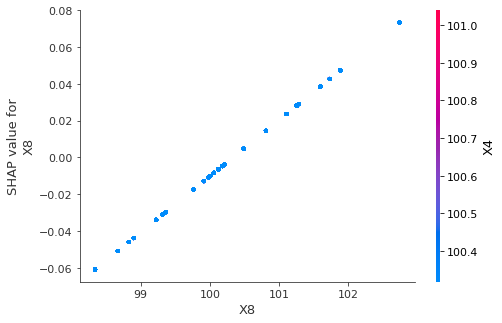

In [101]:
# create a dependence plot to show the effect of a single feature across the whole dataset
for col in cat_cols:
  shap.dependence_plot(col, shap_values,  X_train_js_enc)

Explainer expected value: 100.33461405926947


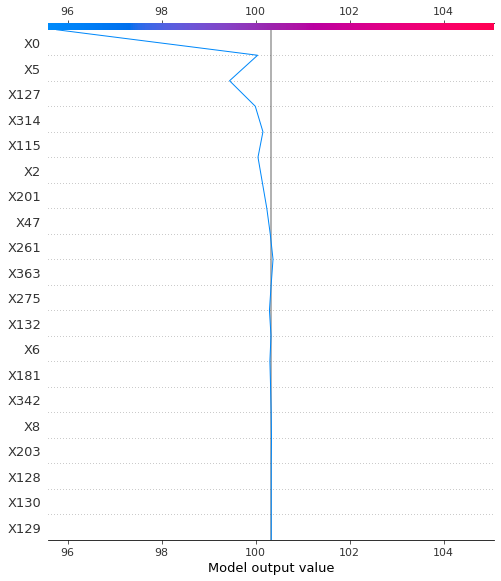

In [129]:
expected_value = explainer.expected_value

if isinstance(expected_value, list):
    expected_value = expected_value[1]
print(f"Explainer expected value: {expected_value}")

select = range(1000)
features = X_train_js_enc.iloc[select]
features_display = X_train_js_enc.loc[features.index]

with warnings.catch_warnings():
    warnings.simplefilter("ignore")
    shap_values = explainer.shap_values(features)[1]

shap.decision_plot(expected_value, shap_values, X_train_js_enc.columns)
